In [1]:
# General Imports
import os
import numpy as np
import pandas as pd
from time import strftime, localtime
import matplotlib.pyplot as plt
from skimage.transform import resize
import seaborn as sn
from sklearn.metrics import accuracy_score, precision_score, recall_score, roc_auc_score, f1_score, cohen_kappa_score

# [TODO] edit the path to the tfslim directoy "https://github.com/tensorflow/models/tree/master/research/slim"
SLIM_PATH = '/srv/workspace/research/mlml/models/research/slim'
os.chdir(SLIM_PATH)

# Deep Learning
import tensorflow as tf
from nets import inception
from datasets import dataset_utils
from preprocessing import inception_preprocessing
from tensorflow.contrib import slim

from sklearn.metrics import accuracy_score, precision_score, recall_score, classification_report, roc_auc_score, \
    hamming_loss
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.utils import check_random_state

plt.rcParams.update({'font.size': 22})

# [TODO] edit the paths to match the machine's directories 
SOURCE_PATH = "/srv/workspace/research/mlml/mlml_weightedLoss/"
# path to the formatted dataset
IMAGES_PATH = "/srv/workspace/research/mlml/datasets/nuswide/image_formatted_npz/"
TEST_IMAGES_PATH = IMAGES_PATH
# path to the output direcorty
OUTPUT_PATH ="/srv/workspace/research/mlml/experiments_results_nus/"
# path to the pretrained model (if not downloaded already, call the download_pretrained_model function below)
PRETRAINED_MODEL_DIR = '/srv/workspace/research/mlml/pretrained_models/'

INPUT_SHAPE = (224, 224, 3)
INPUT_IMAGE_MEAN = [0.485, 0.456, 0.406]
INPUT_IMAGE_STD = [0.229, 0.224, 0.225]

labels_set = pd.read_csv('/srv/workspace/research/mlml/mlml_weightedLoss/labels_balanced_nus/missing_labels0.0/train1_0.0.csv')
labels_set.drop("Unnamed: 0", axis = 1, inplace = True)

labels_names_dir = "/srv/workspace/research/mlml/datasets/nuswide/tags/Concepts81.txt"
LABELS_LIST =  np.asarray([line.rstrip('\n') for line in open(labels_names_dir)])

#LABELS_LIST = labels_set.columns
NUM_CLASSES = len(LABELS_LIST)

# Training paramaeters
BATCH_SIZE = 32
TRAINING_STEPS = int(len(labels_set)/BATCH_SIZE)
NUM_EPOCHS = 20
# compute the weights to balance between the ratio of positive and negative samples per label (not the confidence-based weights) 
Pos_balance_weights = np.round((1 / (np.sum(labels_set.values, axis = 0)/ len(labels_set))/2)).astype(np.float32)

/opt/conda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
# Define helper functions
def download_pretrained_model():
    url = "http://download.tensorflow.org/models/inception_resnet_v2_2016_08_30.tar.gz"
    if not tf.gfile.Exists(PRETRAINED_MODEL_DIR):
        tf.gfile.MakeDirs(PRETRAINED_MODEL_DIR)
    dataset_utils.download_and_uncompress_tarball(url, PRETRAINED_MODEL_DIR)

def get_weights(shape):
    w = tf.Variable(tf.truncated_normal(shape, stddev=0.1))
    #variable_summaries(w)
    return w

def bias_variable(shape):
    initial = tf.constant(0.1, shape=shape)
    b = tf.Variable(initial)
    #variable_summaries(b)
    return b

def full_layer(input, size):
    in_size = int(input.get_shape()[1])
    W = get_weights([in_size, size])
    b = bias_variable([size])
    return tf.matmul(input, W) + b

def dataset_from_csv(csv_path, **kwargs):
    """
        Load dataset from a csv file.
        kwargs are forwarded to the pandas.read_csv function.
    """
    df = pd.read_csv(csv_path, **kwargs)

    dataset = (
        tf.data.Dataset.from_tensor_slices(
            {
                key:df[key].values
                for key in df
            }
        )
    )
    return dataset

def set_tensor_shape(tensor, tensor_shape):
        """
            set shape for a tensor (not in place, as opposed to tf.set_shape)
        """
        tensor.set_shape(tensor_shape)
        return tensor

def nus_labels_idx_to_names(labels,labelnames = LABELS_LIST):
    return labelnames[np.where(labels == 1)[0]]

def load_image_npz(*args):
    """
        loads spectrogram with error tracking.
        args : song ID, path to dataset
        return:
            Features: numpy ndarray, computed features (if no error occured, otherwise: 0)
            Error: boolean, False if no error, True if an error was raised during features computation.
    """
    # TODO: edit path
    path = IMAGES_PATH
    image_id, dummy_path = args
    try:
        image = np.load(os.path.join(path, image_id.decode("utf-8") + '.npz'))['image']
        return image, False
    except Exception as err:
        return np.float32(0.0), True

def load_imge_tf(sample, identifier_key="Unnamed: 0",
                 path="/srv/workspace/research/mlml/datasets/mscoco/train_formatted_npz/", device="/cpu:0",
                 features_key="features"):
    """
        wrap load_images into a tensorflow function.
    """
    with tf.device(device):
        input_args = [sample[identifier_key], tf.constant(path)]
        res = tf.py_func(load_image_npz,
                         input_args,
                         (tf.float32, tf.bool),
                         stateful=False),
        image, error = res[0]
        image = tf.convert_to_tensor(image, dtype=tf.float32)
        res = dict(list(sample.items()) + [(features_key, image), ("error", error)])
        return res

    
# Dataset pipelines
def get_weights_py(image_id):
    weights_negative = global_weights_negative[global_weights_negative.iloc[:,0] == image_id.decode("utf-8")]
    samples_weights_negative = weights_negative.iloc[:, 1:].values.flatten()
    samples_weights_negative = samples_weights_negative.astype(np.float32)
    return samples_weights_negative

def tf_get_weights_py(sample,device = "/cpu:0"):
    with tf.device(device):
        input_args = [sample["Unnamed: 0"]]
        negative_weights = tf.py_func(get_weights_py,
            input_args,
            [tf.float32],
            stateful=False)
        res = dict(list(sample.items()) + [("negative_weights", negative_weights)])
        return res
    

# Dataset pipelines
def get_labels_py(image_id):
    labels = global_labels[global_labels.iloc[:,0] == image_id.decode("utf-8")]
    labels = labels.iloc[:, 1:].values.flatten() # TODO: fix this shift in dataframe columns when read
    labels = labels.astype(np.float32)
    return labels


def tf_get_labels_py(sample, device="/cpu:0"):
    with tf.device(device):
        input_args = [sample["Unnamed: 0"]]
        labels = tf.py_func(get_labels_py,
                            input_args,
                            [tf.float32],
                            stateful=False)
        res = dict(list(sample.items()) + [("binary_label", labels)])
        return res


def get_dataset(input_csv, input_shape=INPUT_SHAPE, batch_size=BATCH_SIZE, shuffle=True,
                infinite_generator=True, random_crop=False,
                num_parallel_calls=32):
    # build dataset from csv file
    dataset = dataset_from_csv(input_csv)
    # Shuffle data
    if shuffle:
        dataset = dataset.shuffle(buffer_size=100, seed=0, reshuffle_each_iteration=True)

    # load image
    dataset = dataset.map(lambda sample: load_imge_tf(sample), num_parallel_calls=1)

    # filter out errors
    dataset = dataset.filter(lambda sample: tf.logical_not(sample["error"]))

    # set features shape
    dataset = dataset.map(lambda sample: dict(sample,
                                              features=set_tensor_shape(sample["features"], input_shape)))

    dataset = dataset.map(lambda sample: tf_get_labels_py(sample), num_parallel_calls=1)

    # set output shape
    dataset = dataset.map(lambda sample: dict(sample, binary_label=set_tensor_shape(
        sample["binary_label"], (NUM_CLASSES))))
    
    # load weights
    dataset = dataset.map(lambda sample: tf_get_weights_py(sample), num_parallel_calls=1)
    
    dataset = dataset.map(lambda sample: dict(sample, negative_weights=set_tensor_shape(
    sample["negative_weights"], (NUM_CLASSES))))
    
    if infinite_generator:
        # Repeat indefinitly
        dataset = dataset.repeat(count=-1)

    # Make batch
    dataset = dataset.batch(batch_size)

    # Select only features and annotation
    dataset = dataset.map(lambda sample: (sample["features"], sample["binary_label"],
                                          sample["negative_weights"]))

    return dataset


def create_analysis_report(model_output, groundtruth, output_path, LABELS_LIST, validation_output=None,
                           validation_groundtruth=None):
    """
    Create a report of all the different evaluation metrics, including optimizing the threshold with the validation set
    if it is passed in the parameters
    """
    # Round the probabilities at 0.5
    model_output_rounded = np.round(model_output)
    model_output_rounded = np.clip(model_output_rounded, 0, 1)
    # Create a dataframe where we keep all the evaluations, starting by prediction accuracy
    accuracies_perclass = sum(model_output_rounded == groundtruth) / len(groundtruth)
    results_df = pd.DataFrame(columns=LABELS_LIST)
    results_df.index.astype(str, copy=False)
    percentage_of_positives_perclass = sum(groundtruth) / len(groundtruth)
    results_df.loc[0] = percentage_of_positives_perclass
    results_df.loc[1] = accuracies_perclass
    results_df.index = ['Ratio of positive samples', 'Model accuracy']

    # plot the accuracies per class
    results_df.T.plot.bar(figsize=(22, 12), fontsize=18)
    plt.title('Model accuracy vs the ratio of positive samples per class')
    plt.xticks(rotation=45)
    plt.savefig(os.path.join(output_path, "accuracies_vs_positiveRate.pdf"), format="pdf")
    plt.savefig(os.path.join(output_path, "accuracies_vs_positiveRate.png"))

    # Getting the true positive rate perclass
    true_positives_ratio_perclass = sum((model_output_rounded == groundtruth) * (groundtruth == 1)) / sum(groundtruth)
    results_df.loc[2] = true_positives_ratio_perclass
    # Get true negative ratio
    true_negative_ratio_perclass = sum((model_output_rounded == groundtruth)
                                       * (groundtruth == 0)) / (len(groundtruth) - sum(groundtruth))
    results_df.loc[3] = true_negative_ratio_perclass
    # compute additional metrics (AUC,f1,recall,precision)
    auc_roc_per_label = roc_auc_score(groundtruth, model_output, average=None)
    precision_perlabel = precision_score(groundtruth, model_output_rounded, average=None)
    recall_perlabel = recall_score(groundtruth, model_output_rounded, average=None)
    f1_perlabel = f1_score(groundtruth, model_output_rounded, average=None)
    kappa_perlabel = [cohen_kappa_score(groundtruth[:, x], model_output_rounded[:, x]) for x in range(len(LABELS_LIST))]
    results_df = results_df.append(
        pd.DataFrame([auc_roc_per_label,recall_perlabel, precision_perlabel, f1_perlabel, kappa_perlabel], columns=LABELS_LIST))
    results_df.index = ['Ratio of positive samples', 'Model accuracy', 'True positives ratio',
                        'True negatives ratio', "AUC", "Recall", "Precision", "f1-score", "Kappa score"]

    # Adjusting threshold based on validation set
    if (validation_groundtruth is not None and validation_output is not None):
        np.savetxt(os.path.join(output_path, 'validation_predictions.out'), validation_output, delimiter=',')
        np.savetxt(os.path.join(output_path, 'valid_ground_truth_classes.txt'), validation_groundtruth, delimiter=',')
        thresholds = np.arange(0, 1, 0.01)
        f1_array = np.zeros((len(LABELS_LIST), len(thresholds)))
        for idx, label in enumerate(LABELS_LIST):
            f1_array[idx, :] = [
                f1_score(validation_groundtruth[:, idx], np.clip(np.round(validation_output[:, idx] - threshold + 0.5), 0, 1))
                for threshold in thresholds]
        threshold_arg = np.argmax(f1_array, axis=1)
        threshold_per_class = thresholds[threshold_arg]

        # plot the f1 score across thresholds
        plt.figure(figsize=(20, 20))
        for idx, x in enumerate(LABELS_LIST):
            plt.plot(thresholds, f1_array[idx, :], linewidth=5)
        plt.legend(LABELS_LIST, loc='best')
        plt.title("F1 Score vs different prediction threshold values for each class")
        plt.savefig(os.path.join(output_path, "f1_score_vs_thresholds.pdf"), format="pdf")
        plt.savefig(os.path.join(output_path, "f1_score_vs_thresholds.png"))

        # Applying thresholds optimized per class
        model_output_rounded = np.zeros_like(model_output)
        for idx, label in enumerate(LABELS_LIST):
            model_output_rounded[:, idx] = np.clip(np.round(model_output[:, idx] - threshold_per_class[idx] + 0.5), 0, 1)

        accuracies_perclass = sum(model_output_rounded == groundtruth) / len(groundtruth)
        # Getting the true positive rate perclass
        true_positives_ratio_perclass = sum((model_output_rounded == groundtruth) * (groundtruth == 1)) / sum(
            groundtruth)
        # Get true negative ratio
        true_negative_ratio_perclass = sum((model_output_rounded == groundtruth)
                                           * (groundtruth == 0)) / (len(groundtruth) - sum(groundtruth))
        results_df = results_df.append(
            pd.DataFrame([accuracies_perclass, true_positives_ratio_perclass,
                          true_negative_ratio_perclass], columns=LABELS_LIST))
        # compute additional metrics (AUC,f1,recall,precision)
        auc_roc_per_label = roc_auc_score(groundtruth, model_output, average=None)
        precision_perlabel = precision_score(groundtruth, model_output_rounded, average=None)
        recall_perlabel = recall_score(groundtruth, model_output_rounded, average=None)
        f1_perlabel = f1_score(groundtruth, model_output_rounded, average=None)
        kappa_perlabel = [cohen_kappa_score(groundtruth[:, x], model_output_rounded[:, x]) for x in
                          range(len(LABELS_LIST))]
        results_df = results_df.append(
            pd.DataFrame([auc_roc_per_label,recall_perlabel, precision_perlabel, f1_perlabel,kappa_perlabel],
                         columns=LABELS_LIST))
        results_df.index = ['Ratio of positive samples', 'Model accuracy', 'True positives ratio',
                            'True negatives ratio', "AUC", "Precision", "Recall", "f1-score",  "Kappa score",
                            'Optimized model accuracy', 'Optimized true positives ratio',
                            'Optimized true negatives ratio', "Optimized AUC",
                            "Optimized precision", "Optimized recall", "Optimized f1-score",  "Optimized Kappa score"]

    results_df['average'] = results_df.mean(numeric_only=True, axis=1)
    results_df.T.to_csv(os.path.join(output_path, "results_report.csv"), float_format="%.2f")
    return results_df


def evaluate_model(test_pred_prob, test_classes, saving_path, evaluation_file_path):
    """
    Evaluates a given model using accuracy, area under curve and hamming loss
    :param model: model to be evaluated
    :param spectrograms: the test set spectrograms as an np.array
    :param test_classes: the ground truth labels
    :return: accuracy, auc_roc, hamming_error
    """
    test_pred = np.round(test_pred_prob)
    # Accuracy
    accuracy = 100 * accuracy_score(test_classes, test_pred)
    print("Exact match accuracy is: " + str(accuracy) + "%")
    # Area Under the Receiver Operating Characteristic Curve (ROC AUC)
    auc_roc = roc_auc_score(test_classes, test_pred_prob)
    print("Macro Area Under the Curve (AUC) is: " + str(auc_roc))
    auc_roc_micro = roc_auc_score(test_classes, test_pred_prob, average="micro")
    print("Micro Area Under the Curve (AUC) is: " + str(auc_roc_micro))
    auc_roc_weighted = roc_auc_score(test_classes, test_pred_prob, average="weighted")
    print("Weighted Area Under the Curve (AUC) is: " + str(auc_roc_weighted))
    # Hamming loss is the fraction of labels that are incorrectly predicted.
    hamming_error = hamming_loss(test_classes, test_pred)
    print("Hamming Loss (ratio of incorrect tags) is: " + str(hamming_error))
    with open(evaluation_file_path, "w") as f:
        f.write("Exact match accuracy is: " + str(accuracy) + "%\n" + "Area Under the Curve (AUC) is: " + str(auc_roc)
                + "\nMicro AUC is:" + str(auc_roc_micro) + "\nWeighted AUC is:" + str(auc_roc_weighted)
                + "\nHamming Loss (ratio of incorrect tags) is: " + str(hamming_error))
    print("saving prediction to disk")
    np.savetxt(os.path.join(saving_path, 'predictions.out'), test_pred_prob, delimiter=',')
    np.savetxt(os.path.join(saving_path, 'test_ground_truth_classes.txt'), test_classes, delimiter=',')
    return accuracy, auc_roc, hamming_error

In [ ]:
def weighted_loss(y_true, y_pred, positive_weights, negative_weights):
    # clip to prevent NaN's and Inf's
    y_pred = tf.clip_by_value(y_pred, 1e-7, 1-1e-7, name=None)
    #y_pred = K.clip(y_pred, K.epsilon(), 1 - K.epsilon())
    # calc
    loss = (-y_true * tf.log(y_pred) * positive_weights) - ((1.0 - y_true) * tf.log(1.0 - y_pred) * negative_weights)
    loss = tf.reduce_mean(loss)
    return loss

## fine-tune pretrained model on the dataset

Current Experiment: nus_3labels_correlations_CE0.0split_1



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.0split_1/30-12_13-46
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.9454 accuracy: 0.8670
Epoch #3 Loss: 0.9013 accuracy: 0.9513
Epoch #4 Loss: 0.8916 accuracy: 0.9513
Epoch #5 Loss: 0.8801 accuracy: 0.9511
Epoch #6 Loss: 0.8664 accuracy: 0.9509
Epoch #7 Loss: 0.8558 accuracy: 0.9504
Epoch #8 Loss: 0.8432 accuracy: 0.9502
Epoch #9 Loss: 0.8312 accuracy: 0.9496
Epoch #10 Loss: 0.8189 accuracy: 0.9492
Epoch #11 Loss: 0.8067 accuracy: 0.9483
Epoch #12 Loss: 0.7940 accuracy: 0.9473
Epoch #13 Loss: 0.7824 accuracy: 0.9461
Epoch #14 Loss: 0.7716 accuracy: 0.9444
Epoch #15 Loss: 0.7593 accuracy: 0.9426

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


Current Experiment: nus_3labels_correlations_CE0.2split_1



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.2split_1/30-12_14-34
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.7905 accuracy: 0.8937
Epoch #2 Loss: 0.7490 accuracy: 0.9663
Epoch #3 Loss: 0.7417 accuracy: 0.9663
Epoch #4 Loss: 0.7369 accuracy: 0.9663
Epoch #5 Loss: 0.7288 accuracy: 0.9663
Epoch #6 Loss: 0.7203 accuracy: 0.9662
Epoch #7 Loss: 0.7124 accuracy: 0.9662
Epoch #8 Loss: 0.7034 accuracy: 0.9661
Epoch #9 Loss: 0.6945 accuracy: 0.9660
Epoch #10 Loss: 0.6854 accuracy: 0.9659
Epoch #11 Loss: 0.6770 accuracy: 0.9658
Epoch #12 Loss: 0.6674 accuracy: 0.9657
Epoch #13 Loss: 0.6589 accuracy: 0.9656
Epoch #14 Loss: 0.6502 accuracy: 0.9653


/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


Current Experiment: nus_3labels_correlations_CE0.5split_1



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.5split_1/30-12_15-23
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.6002 accuracy: 0.9165
Epoch #2 Loss: 0.5415 accuracy: 0.9794
Epoch #3 Loss: 0.5384 accuracy: 0.9794
Epoch #4 Loss: 0.5365 accuracy: 0.9794
Epoch #5 Loss: 0.5341 accuracy: 0.9794
Epoch #6 Loss: 0.5307 accuracy: 0.9794
Epoch #7 Loss: 0.5269 accuracy: 0.9794
Epoch #8 Loss: 0.5225 accuracy: 0.9794
Epoch #9 Loss: 0.5186 accuracy: 0.9794
Epoch #10 Loss: 0.5148 accuracy: 0.9794
Epoch #11 Loss: 0.5095 accuracy: 0.9794
Epoch #12 Loss: 0.5046 accuracy: 0.9793
Epoch #13 Loss: 0.4988 accuracy: 0.9794
Epoch #14 Loss: 0.4953 accuracy: 0.9793


/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


Current Experiment: nus_3labels_correlations_CE0.8split_1



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.8split_1/30-12_16-12
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.5011 accuracy: 0.9273
Epoch #2 Loss: 0.4274 accuracy: 0.9865
Epoch #3 Loss: 0.4247 accuracy: 0.9865
Epoch #4 Loss: 0.4250 accuracy: 0.9865
Epoch #5 Loss: 0.4234 accuracy: 0.9865
Epoch #6 Loss: 0.4210 accuracy: 0.9865
Epoch #7 Loss: 0.4190 accuracy: 0.9865
Epoch #8 Loss: 0.4167 accuracy: 0.9865
Epoch #9 Loss: 0.4143 accuracy: 0.9865
Epoch #10 Loss: 0.4111 accuracy: 0.9865
Epoch #11 Loss: 0.4079 accuracy: 0.9865
Epoch #12 Loss: 0.4041 accuracy: 0.9865
Epoch #13 Loss: 0.4018 accuracy: 0.9865
Epoch #14 Loss: 0.3981 accuracy: 0.9865


/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Current Experiment: nus_3labels_correlations_CE0.0split_2



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.0split_2/30-12_17-01
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.9482 accuracy: 0.8705
Epoch #2 Loss: 0.9155 accuracy: 0.9511
Epoch #3 Loss: 0.9072 accuracy: 0.9511
Epoch #4 Loss: 0.8964 accuracy: 0.9510
Epoch #5 Loss: 0.8860 accuracy: 0.9510
Epoch #6 Loss: 0.8744 accuracy: 0.9508
Epoch #7 Loss: 0.8644 accuracy: 0.9507
Epoch #8 Loss: 0.8526 accuracy: 0.9503
Epoch #9 Loss: 0.8414 accuracy: 0.9500
Epoch #10 Loss: 0.8288 accuracy: 0.9497
Epoch #11 Loss: 0.8182 accuracy: 0.9490
Epoch #12 Loss: 0.8048 accuracy: 0.9480
Epoch #13 Loss: 0.7943 accuracy: 0.9471
Epoch #14 Loss: 0.7835 accuracy: 0.9455


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

Current Experiment: nus_3labels_correlations_CE0.2split_2



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.2split_2/30-12_17-50
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.7923 accuracy: 0.8908
Epoch #2 Loss: 0.7502 accuracy: 0.9663
Epoch #3 Loss: 0.7453 accuracy: 0.9663
Epoch #5 Loss: 0.7317 accuracy: 0.9662
Epoch #6 Loss: 0.7240 accuracy: 0.9662
Epoch #7 Loss: 0.7169 accuracy: 0.9662
Epoch #8 Loss: 0.7087 accuracy: 0.9661
Epoch #9 Loss: 0.7009 accuracy: 0.9661
Epoch #10 Loss: 0.6907 accuracy: 0.9661
Epoch #11 Loss: 0.6847 accuracy: 0.9660
Epoch #12 Loss: 0.6751 accuracy: 0.9659
Epoch #13 Loss: 0.6664 accuracy: 0.9658
Epoch #14 Loss: 0.6587 accuracy: 0.9656
Epoch #15 Loss: 0.6506 accuracy: 0.9655

/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

Current Experiment: nus_3labels_correlations_CE0.5split_2



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.5split_2/30-12_18-39
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.5931 accuracy: 0.9382
Epoch #2 Loss: 0.5472 accuracy: 0.9793
Epoch #3 Loss: 0.5446 accuracy: 0.9793
Epoch #4 Loss: 0.5406 accuracy: 0.9793
Epoch #5 Loss: 0.5378 accuracy: 0.9793
Epoch #6 Loss: 0.5333 accuracy: 0.9793
Epoch #7 Loss: 0.5297 accuracy: 0.9793
Epoch #8 Loss: 0.5246 accuracy: 0.9793
Epoch #9 Loss: 0.5203 accuracy: 0.9793
Epoch #10 Loss: 0.5149 accuracy: 0.9793
Epoch #11 Loss: 0.5103 accuracy: 0.9793
Epoch #12 Loss: 0.5047 accuracy: 0.9793
Epoch #13 Loss: 0.4999 accuracy: 0.9793
Epoch #14 Loss: 0.4952 accuracy: 0.9793


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

Current Experiment: nus_3labels_correlations_CE0.8split_2



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.8split_2/30-12_19-30
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.4938 accuracy: 0.9423
Epoch #2 Loss: 0.4272 accuracy: 0.9865
Epoch #3 Loss: 0.4256 accuracy: 0.9865
Epoch #4 Loss: 0.4242 accuracy: 0.9865
Epoch #5 Loss: 0.4228 accuracy: 0.9865
Epoch #6 Loss: 0.4200 accuracy: 0.9865
Epoch #7 Loss: 0.4184 accuracy: 0.9865
Epoch #8 Loss: 0.4162 accuracy: 0.9865
Epoch #9 Loss: 0.4141 accuracy: 0.9865
Epoch #10 Loss: 0.4104 accuracy: 0.9865
Epoch #11 Loss: 0.4087 accuracy: 0.9865
Epoch #12 Loss: 0.4041 accuracy: 0.9865
Epoch #13 Loss: 0.4011 accuracy: 0.9865
Epoch #14 Loss: 0.3986 accuracy: 0.9865


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

Current Experiment: nus_3labels_correlations_CE0.0split_3



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.0split_3/30-12_20-19
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.9409 accuracy: 0.8807
Epoch #2 Loss: 0.9134 accuracy: 0.9510
Epoch #3 Loss: 0.9042 accuracy: 0.9511
Epoch #4 Loss: 0.8939 accuracy: 0.9508
Epoch #5 Loss: 0.8820 accuracy: 0.9507
Epoch #6 Loss: 0.8702 accuracy: 0.9506
Epoch #7 Loss: 0.8577 accuracy: 0.9505
Epoch #8 Loss: 0.8463 accuracy: 0.9504
Epoch #9 Loss: 0.8336 accuracy: 0.9500
Epoch #10 Loss: 0.8210 accuracy: 0.9497
Epoch #11 Loss: 0.8096 accuracy: 0.9490
Epoch #12 Loss: 0.7956 accuracy: 0.9480
Epoch #13 Loss: 0.7839 accuracy: 0.9467
Epoch #14 Loss: 0.7741 accuracy: 0.9449


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

Current Experiment: nus_3labels_correlations_CE0.2split_3



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.2split_3/30-12_21-08
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.7844 accuracy: 0.9030
Epoch #2 Loss: 0.7494 accuracy: 0.9663
Epoch #3 Loss: 0.7435 accuracy: 0.9663
Epoch #4 Loss: 0.7363 accuracy: 0.9662
Epoch #5 Loss: 0.7278 accuracy: 0.9662
Epoch #6 Loss: 0.7194 accuracy: 0.9662
Epoch #7 Loss: 0.7116 accuracy: 0.9662
Epoch #8 Loss: 0.7037 accuracy: 0.9662
Epoch #9 Loss: 0.6951 accuracy: 0.9662
Epoch #10 Loss: 0.6859 accuracy: 0.9661
Epoch #11 Loss: 0.6774 accuracy: 0.9660
Epoch #12 Loss: 0.6684 accuracy: 0.9659
Epoch #13 Loss: 0.6588 accuracy: 0.9657
Epoch #14 Loss: 0.6496 accuracy: 0.9653


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

Current Experiment: nus_3labels_correlations_CE0.5split_3



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.5split_3/30-12_21-57
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.5997 accuracy: 0.9165
Epoch #2 Loss: 0.5406 accuracy: 0.9793
Epoch #3 Loss: 0.5380 accuracy: 0.9793
Epoch #4 Loss: 0.5353 accuracy: 0.9793
Epoch #5 Loss: 0.5308 accuracy: 0.9793
Epoch #6 Loss: 0.5280 accuracy: 0.9793
Epoch #7 Loss: 0.5236 accuracy: 0.9793
Epoch #8 Loss: 0.5202 accuracy: 0.9793
Epoch #9 Loss: 0.5151 accuracy: 0.9793
Epoch #10 Loss: 0.5105 accuracy: 0.9793
Epoch #11 Loss: 0.5057 accuracy: 0.9793
Epoch #12 Loss: 0.4999 accuracy: 0.9793
Epoch #13 Loss: 0.4950 accuracy: 0.9793
Epoch #14 Loss: 0.4905 accuracy: 0.9793


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

Current Experiment: nus_3labels_correlations_CE0.8split_3



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.8split_3/30-12_22-47
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.4879 accuracy: 0.9415
Epoch #2 Loss: 0.4249 accuracy: 0.9865
Epoch #3 Loss: 0.4226 accuracy: 0.9865
Epoch #4 Loss: 0.4210 accuracy: 0.9865
Epoch #5 Loss: 0.4180 accuracy: 0.9865
Epoch #6 Loss: 0.4156 accuracy: 0.9865
Epoch #7 Loss: 0.4130 accuracy: 0.9865
Epoch #8 Loss: 0.4095 accuracy: 0.9865
Epoch #9 Loss: 0.4063 accuracy: 0.9865
Epoch #10 Loss: 0.4032 accuracy: 0.9865
Epoch #11 Loss: 0.3992 accuracy: 0.9865
Epoch #12 Loss: 0.3961 accuracy: 0.9864
Epoch #13 Loss: 0.3927 accuracy: 0.9864
Epoch #14 Loss: 0.3882 accuracy: 0.9864


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

Current Experiment: nus_3labels_correlations_CE0.0split_4



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.0split_4/30-12_23-37
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.9409 accuracy: 0.8796
Epoch #2 Loss: 0.9116 accuracy: 0.9510
Epoch #3 Loss: 0.9027 accuracy: 0.9509
Epoch #4 Loss: 0.8899 accuracy: 0.9508
Epoch #5 Loss: 0.8799 accuracy: 0.9505
Epoch #6 Loss: 0.8661 accuracy: 0.9504
Epoch #7 Loss: 0.8562 accuracy: 0.9501
Epoch #8 Loss: 0.8449 accuracy: 0.9498
Epoch #9 Loss: 0.8319 accuracy: 0.9498
Epoch #10 Loss: 0.8203 accuracy: 0.9492
Epoch #11 Loss: 0.8084 accuracy: 0.9485
Epoch #12 Loss: 0.7954 accuracy: 0.9476
Epoch #13 Loss: 0.7843 accuracy: 0.9463
Epoch #14 Loss: 0.7723 accuracy: 0.9448


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

Current Experiment: nus_3labels_correlations_CE0.2split_4



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.2split_4/31-12_00-26
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.7803 accuracy: 0.9050
Epoch #2 Loss: 0.7457 accuracy: 0.9664
Epoch #3 Loss: 0.7412 accuracy: 0.9664
Epoch #4 Loss: 0.7322 accuracy: 0.9664
Epoch #5 Loss: 0.7263 accuracy: 0.9663
Epoch #6 Loss: 0.7165 accuracy: 0.9663
Epoch #7 Loss: 0.7099 accuracy: 0.9661
Epoch #8 Loss: 0.7024 accuracy: 0.9661
Epoch #9 Loss: 0.6940 accuracy: 0.9660
Epoch #10 Loss: 0.6849 accuracy: 0.9660
Epoch #11 Loss: 0.6765 accuracy: 0.9659
Epoch #12 Loss: 0.6673 accuracy: 0.9658
Epoch #14 Loss: 0.6496 accuracy: 0.9653
Epoch #15 Loss: 0.6409 accuracy: 0.9649


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

Current Experiment: nus_3labels_correlations_CE0.5split_4



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.5split_4/31-12_01-15
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.5843 accuracy: 0.9372
Epoch #2 Loss: 0.5400 accuracy: 0.9794
Epoch #3 Loss: 0.5378 accuracy: 0.9794
Epoch #4 Loss: 0.5333 accuracy: 0.9794
Epoch #5 Loss: 0.5323 accuracy: 0.9794
Epoch #6 Loss: 0.5273 accuracy: 0.9794
Epoch #7 Loss: 0.5244 accuracy: 0.9794
Epoch #8 Loss: 0.5205 accuracy: 0.9794
Epoch #9 Loss: 0.5162 accuracy: 0.9794
Epoch #10 Loss: 0.5124 accuracy: 0.9794
Epoch #11 Loss: 0.5076 accuracy: 0.9794
Epoch #12 Loss: 0.5025 accuracy: 0.9794
Epoch #13 Loss: 0.4977 accuracy: 0.9793
Epoch #14 Loss: 0.4924 accuracy: 0.9793


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

Current Experiment: nus_3labels_correlations_CE0.8split_4



INFO:tensorflow:Summary name Weighted cross entropy is illegal; using Weighted_cross_entropy instead.
Execute the following in a terminal:
tensorboard --logdir=/srv/workspace/research/mlml/experiments_results_nus/nus_3labels_correlations_CE0.8split_4/31-12_02-04
INFO:tensorflow:Restoring parameters from /srv/workspace/research/mlml/pretrained_models/inception_resnet_v2_2016_08_30.ckpt
Epoch #1 Loss: 0.5008 accuracy: 0.9184
Epoch #2 Loss: 0.4192 accuracy: 0.9865
Epoch #3 Loss: 0.4185 accuracy: 0.9865
Epoch #4 Loss: 0.4161 accuracy: 0.9865
Epoch #5 Loss: 0.4155 accuracy: 0.9865
Epoch #6 Loss: 0.4127 accuracy: 0.9865
Epoch #7 Loss: 0.4120 accuracy: 0.9865
Epoch #8 Loss: 0.4098 accuracy: 0.9865
Epoch #9 Loss: 0.4067 accuracy: 0.9865
Epoch #10 Loss: 0.4042 accuracy: 0.9865
Epoch #11 Loss: 0.4014 accuracy: 0.9865
Epoch #12 Loss: 0.3986 accuracy: 0.9865
Epoch #13 Loss: 0.3961 accuracy: 0.9865
Epoch #14 Loss: 0.3925 accuracy: 0.9865


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (

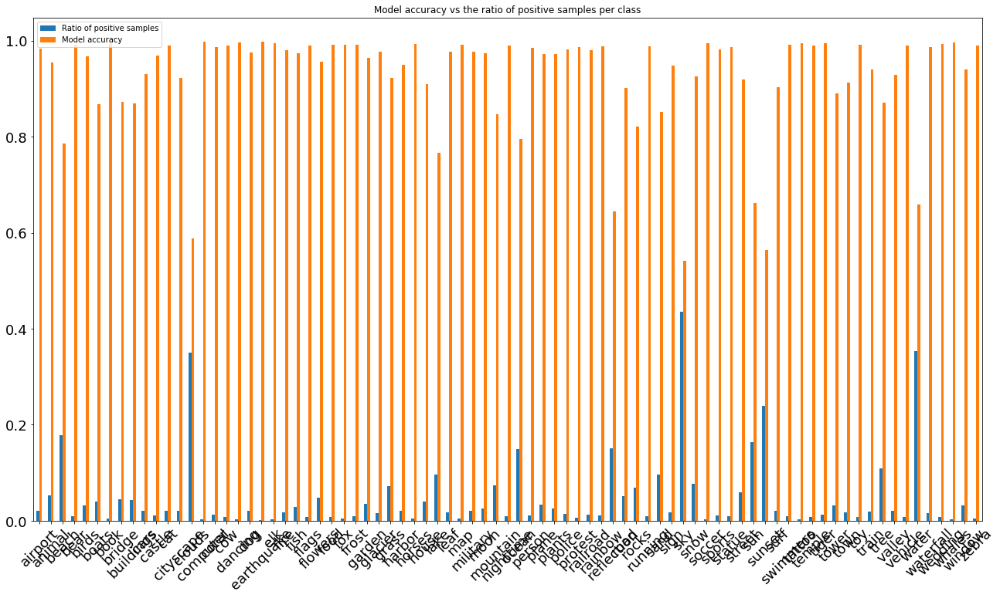

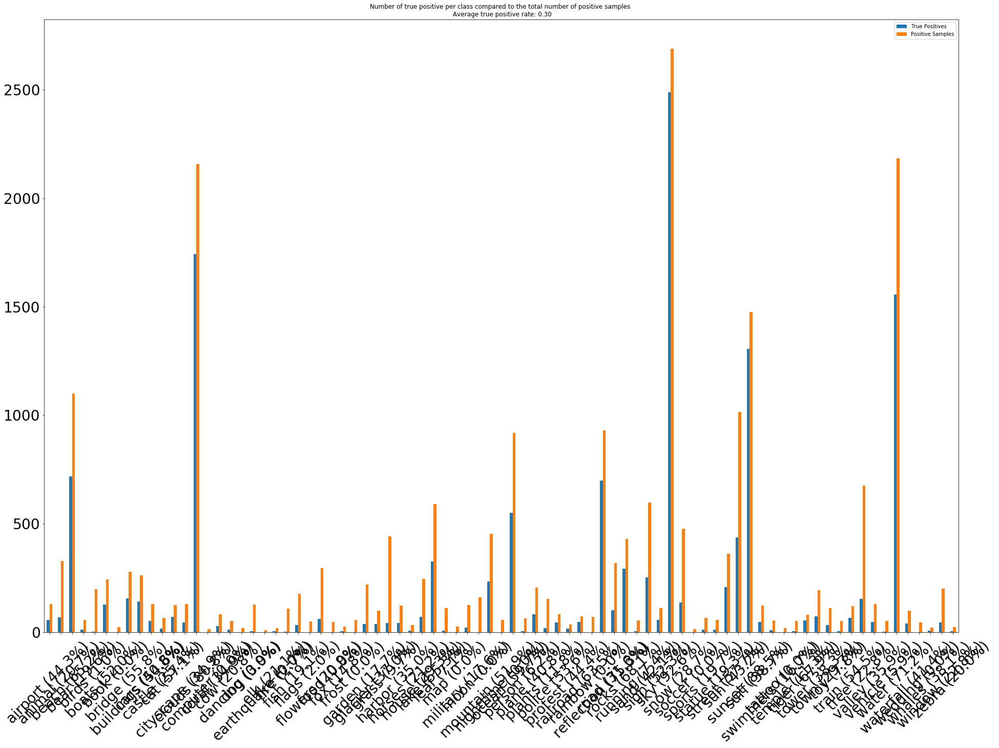

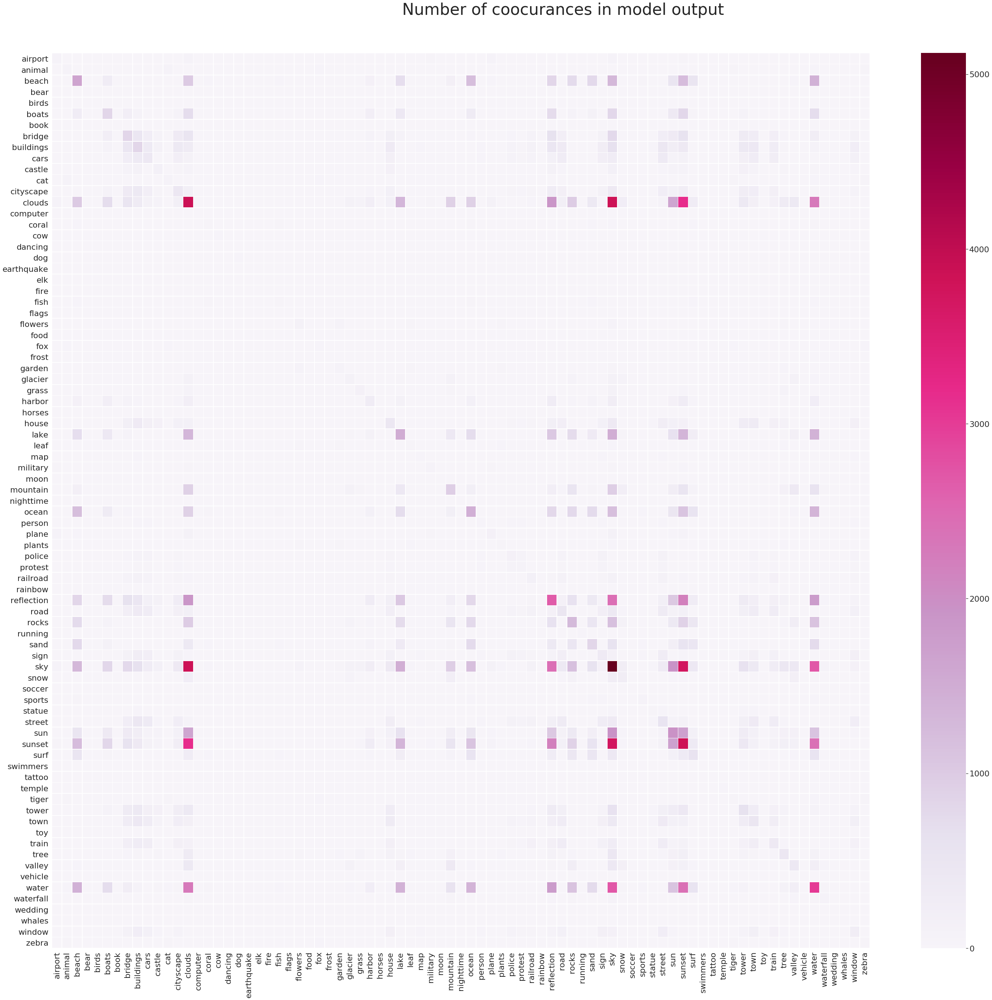

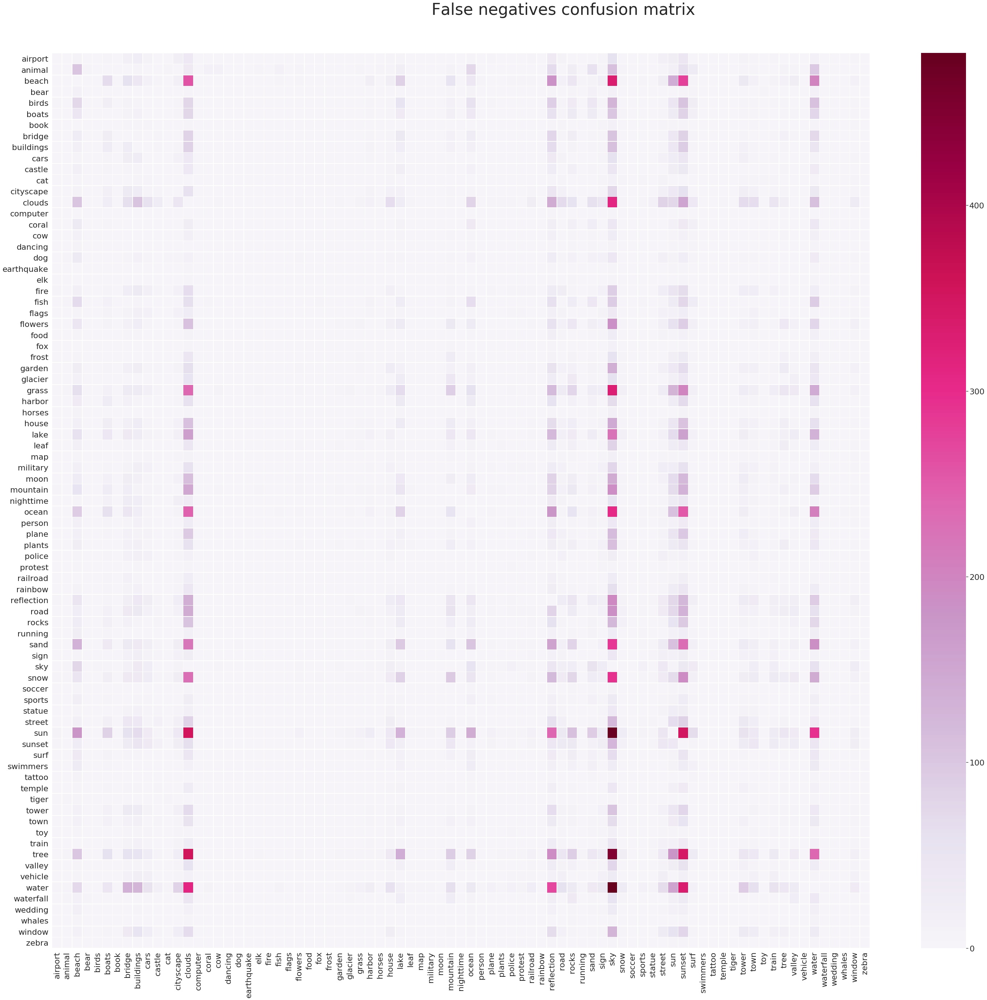

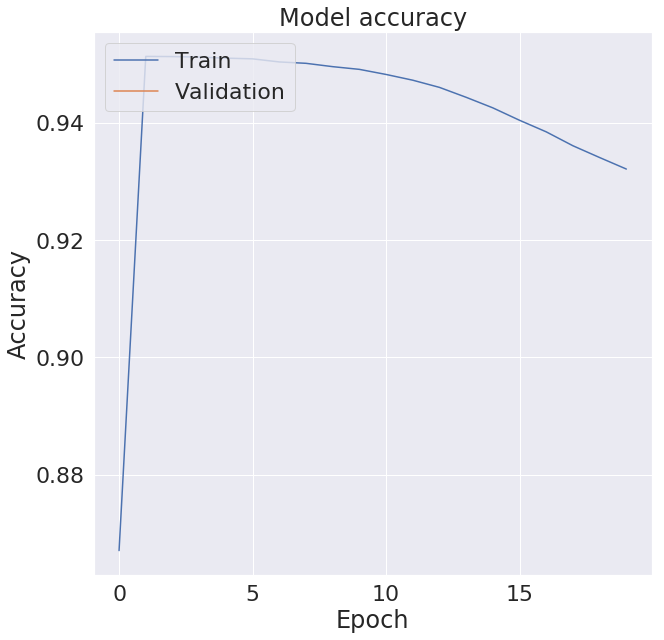

...

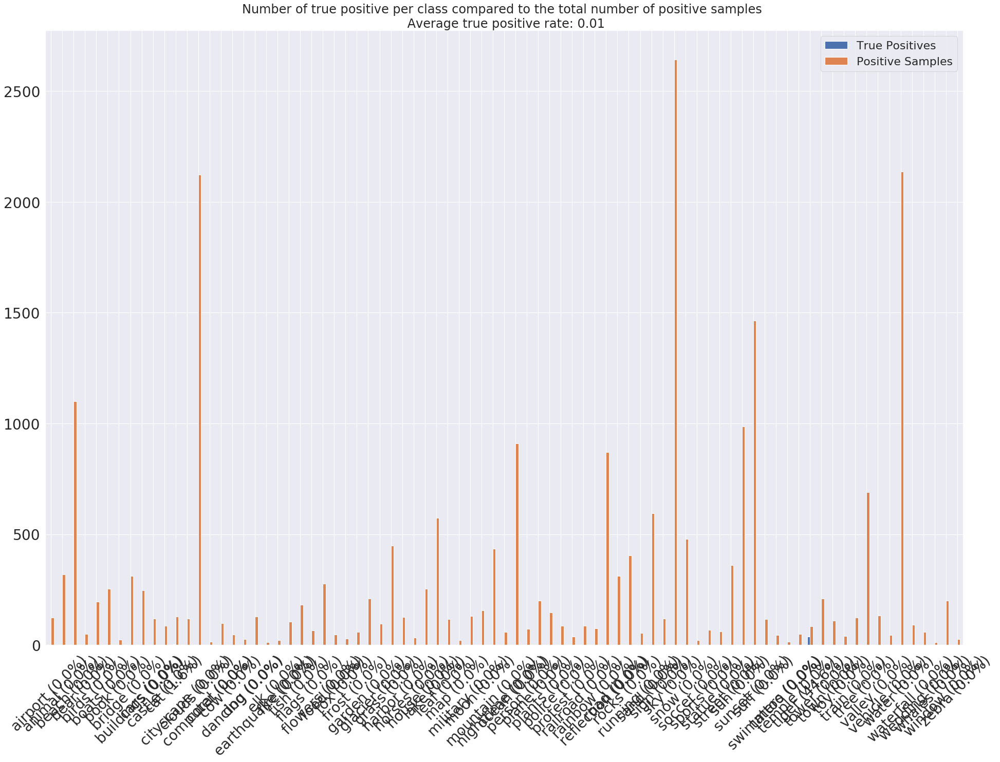

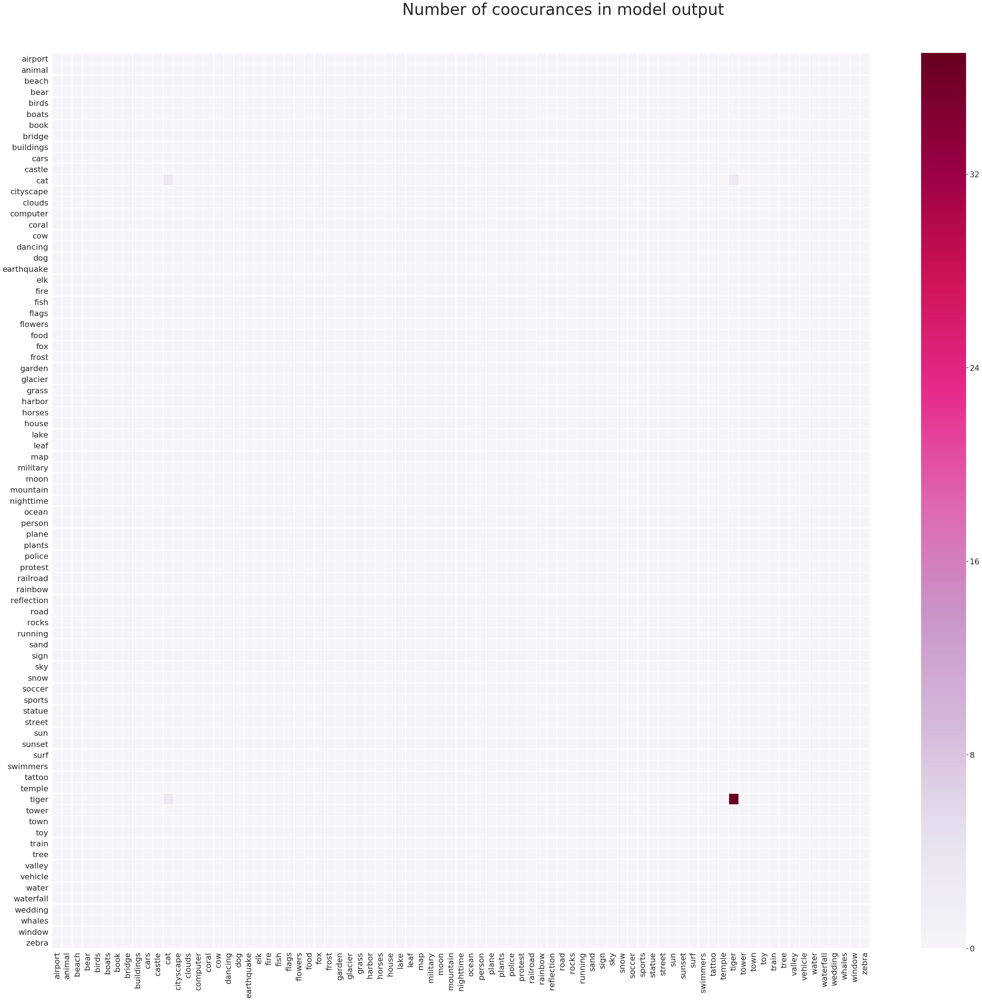

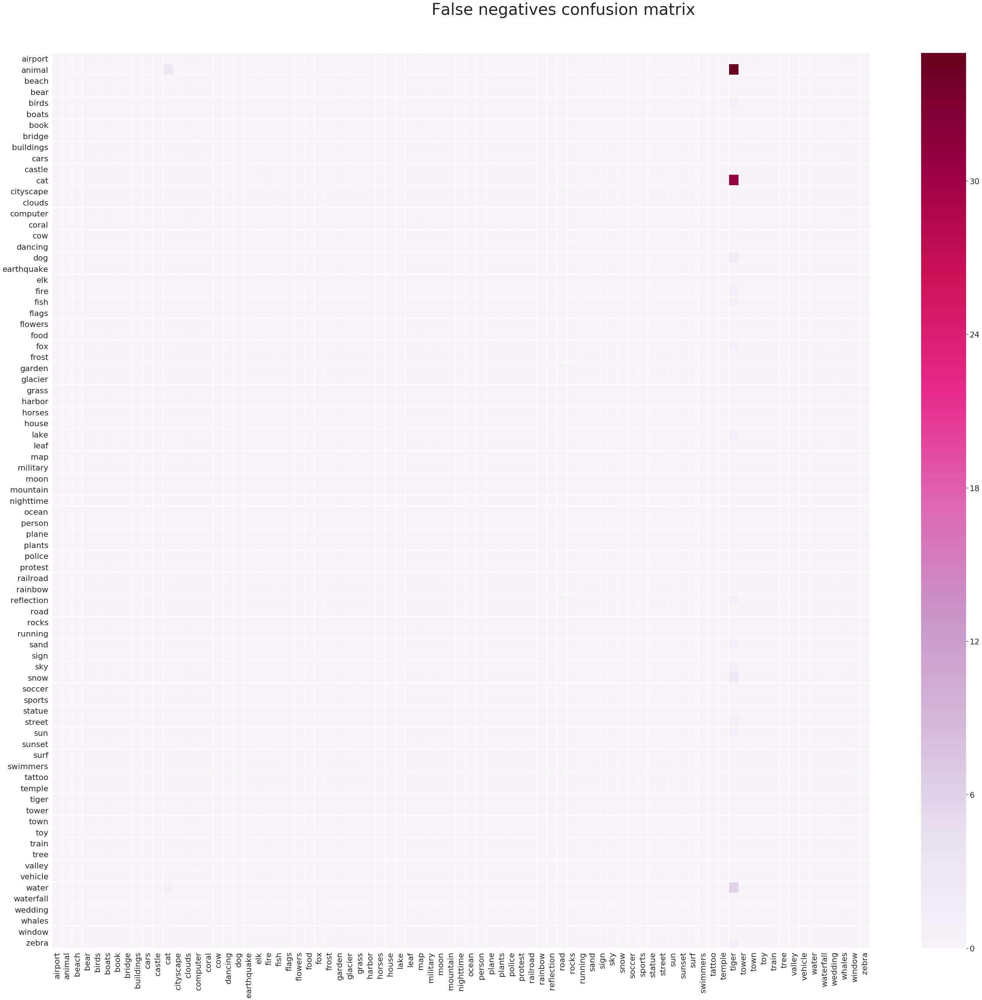

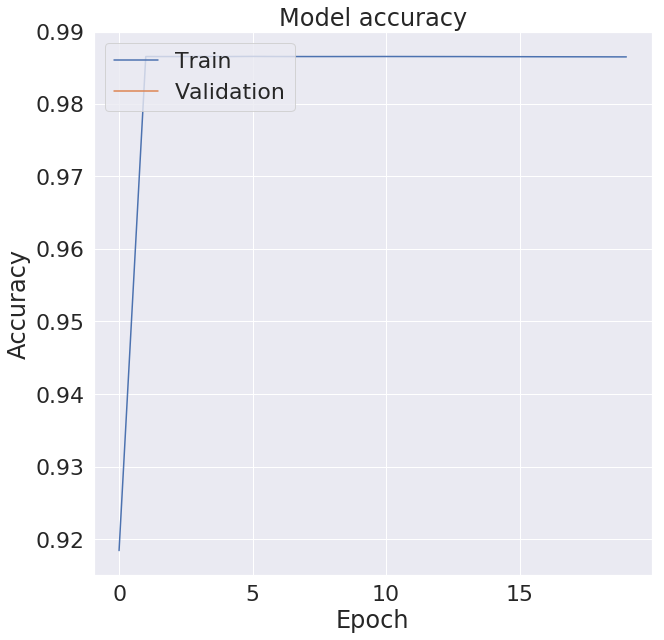

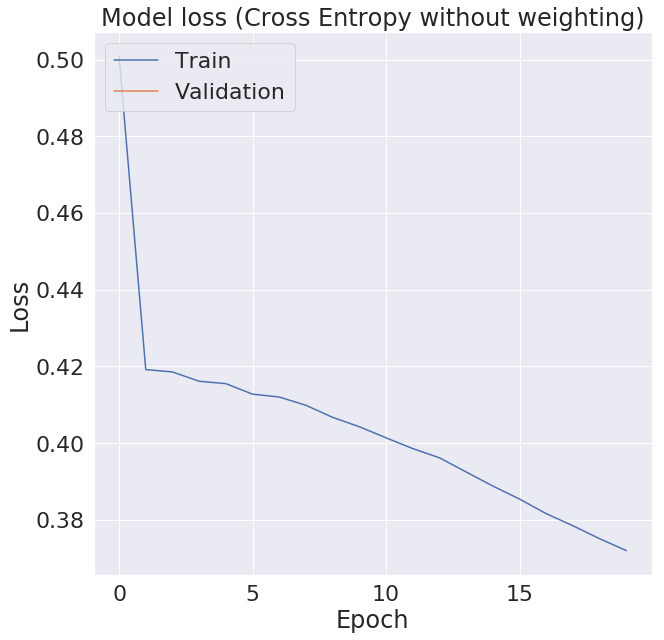

In [3]:
for split in np.arange(1,5):
    for ratio in np.arange(0,1,0.25): 
        tf.reset_default_graph()
        EXPERIMENTNAME = "nus_3labels_correlations_CE" + str(round(ratio, 1)) + "split_" + str(split)
        print("Current Experiment: " + EXPERIMENTNAME + "\n\n\n")
        global_labels = pd.read_csv('/srv/workspace/research/mlml/mlml_weightedLoss/labels_balanced_nus/missing_labels'+
                                    str(round(ratio, 1))+'/train' + str(split) +"_" + str(round(ratio, 1)) + '.csv')
        # Loading datasets
        training_dataset = get_dataset('/srv/workspace/research/mlml/mlml_weightedLoss/labels_balanced_nus/missing_labels'+
                                    str(round(ratio, 1))+'/train' + str(split) +"_" + str(round(ratio, 1)) + '.csv')
        
        global_weights_negative = pd.read_csv('/srv/workspace/research/mlml/mlml_weightedLoss/labels_balanced_nus/negative_weights_global.csv')

        with tf.Graph().as_default():
            # Setting up training generator
            training_iterator = training_dataset.make_one_shot_iterator()
            training_next_element = training_iterator.get_next()

            # Setting up variables
            input_labels = tf.placeholder(tf.float32, [None, NUM_CLASSES], name="true_labels")
            negative_weights = tf.placeholder(tf.float32, [None, NUM_CLASSES], name="negative_weights")
            input_images = tf.placeholder(tf.float32, [None, 224, 224, 3], name="input")
            train_phase = tf.placeholder(tf.bool, name="is_training")

            # Create the model, use the default arg scope to configure the batch norm parameters.
            with slim.arg_scope(inception.inception_resnet_v2_arg_scope()):
                ignored_logits, end_points = inception.inception_resnet_v2(input_images, num_classes=NUM_CLASSES, 
                                                           is_training=train_phase)
            
            featured_extracted = end_points['Conv2d_7b_1x1']
            
            with tf.name_scope('trainable/Fully_connected_1'):
                flattened = tf.reshape(featured_extracted, [-1, 5*5* 1536])
                fully1 = tf.nn.sigmoid(full_layer(flattened, 2048))
                
            with tf.name_scope('trainable/Fully_connected_2'):
                fully2 = tf.nn.sigmoid(full_layer(fully1, 1024))

            with tf.name_scope('trainable/Fully_connected_3'):
                fully3 = tf.nn.sigmoid(full_layer(fully2, 256))
                
                
            with tf.name_scope('trainable/Fully_connected_4'):
                #dropped = tf.nn.dropout(fully1, keep_prob=current_keep_prob)
                output_logits = full_layer(fully3, NUM_CLASSES)

            trainable_layers = [var for var in tf.global_variables() if ("trainable" in var.op.name)]
            # Defining loss and metrics
            # Define loss and training optimizer
            positive_imbalance_weights = tf.constant(Pos_balance_weights)

            probabilities = tf.nn.sigmoid(output_logits)
            tf.summary.histogram('outputs', probabilities)
            
                        
            my_weights_loss = weighted_loss(y_true= input_labels, y_pred= probabilities,
                  positive_weights= positive_imbalance_weights, negative_weights= negative_weights)
                

            global_step = tf.Variable(0, trainable=False)
            learning_rate = tf.train.exponential_decay(learning_rate=0.1, global_step=global_step, decay_steps=1000,
                                                      decay_rate=0.95,staircase=True)
            train_step = tf.train.AdadeltaOptimizer(learning_rate).minimize(my_weights_loss,
                                                                            var_list=trainable_layers)            #my_weights_loss = weighted_loss(y_true= y, y_pred= model_output,

            # define accuracy
            correct_prediction = tf.equal(tf.round(probabilities), input_labels)
            accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))

            # Adding tensorboard summaries
            tf.summary.scalar('Weighted cross entropy',  my_weights_loss)
            tf.summary.scalar('Accuracy', accuracy)
            # Merge all the summaries
            merged = tf.summary.merge_all()

            # restoring pretrained model weights
            checkpoint_exclude_scopes = ["InceptionResnetV2/Logits", "InceptionResnetV2/AuxLogits"]
            exclusions = [scope.strip() for scope in checkpoint_exclude_scopes]
            variables_to_restore = []
            for var in slim.get_model_variables():
                for exclusion in exclusions:
                    if var.op.name.startswith(exclusion):
                        break
                else:
                    variables_to_restore.append(var)
            init_fn = slim.assign_from_checkpoint_fn(
                os.path.join(PRETRAINED_MODEL_DIR, 'inception_resnet_v2_2016_08_30.ckpt'),
                variables_to_restore)

            # Setting up saving directory
            experiment_name = strftime("%d-%m_%H-%M", localtime())
            exp_dir = os.path.join(OUTPUT_PATH, EXPERIMENTNAME, experiment_name)

            # Add ops to save and restore all the variables.
            saver = tf.train.Saver()

            epoch_losses_history, epoch_accurcies_history, val_losses_history, val_accuracies_history = [], [], [], []
            #my_loss_history, my_loss_val_history = [], []
            with tf.Session() as sess:
                # Write summaries to LOG_DIR -- used by TensorBoard
                train_writer = tf.summary.FileWriter(exp_dir + '/tensorboard/train', graph=tf.get_default_graph())
                test_writer = tf.summary.FileWriter(exp_dir + '/tensorboard/test', graph=tf.get_default_graph())
                print("Execute the following in a terminal:\n" + "tensorboard --logdir=" + exp_dir)
                sess.run(tf.global_variables_initializer())
                init_fn(sess)
                for epoch in range(NUM_EPOCHS):
                    batch_loss, batch_accuracy = np.zeros([TRAINING_STEPS, 1]), np.zeros([TRAINING_STEPS, 1])
                    for batch_counter in range(TRAINING_STEPS):
                        batch = sess.run(training_next_element)
                        batch_images = batch[0]
                        batch_labels = np.squeeze(batch[1])
                        batch_negative_weights = np.squeeze(batch[2])
                        summary, batch_loss[batch_counter], batch_accuracy[batch_counter], _ \
                        = sess.run([merged, my_weights_loss, accuracy, train_step],
                                   feed_dict={input_images:batch_images,
                                              input_labels:batch_labels,
                                              negative_weights: batch_negative_weights,
                                              train_phase:True})
                    print("Epoch #{}".format(epoch+1), "Loss: {:.4f}".format(np.mean(batch_loss)),
                          "accuracy: {:.4f}".format(np.mean(batch_accuracy)))
                    # Add to summaries
                    train_writer.add_summary(summary, epoch)
                    
                os.makedirs(os.path.join(PRETRAINED_MODEL_DIR,EXPERIMENTNAME,experiment_name))
                save_path = saver.save(sess, os.path.join(PRETRAINED_MODEL_DIR,EXPERIMENTNAME, 
                                              experiment_name, "last_epoch.ckpt"))
                
                # Testing the model
                test_split = '/srv/workspace/research/mlml/mlml_weightedLoss/labels_balanced_nus/missing_labels'+ \
                                    str(round(ratio, 1))+'/test' + str(split) + "_" + str(round(ratio, 1)) + '.csv'
                global_labels = pd.read_csv(test_split)
                test_dataset = get_dataset(test_split)
                test_classes = np.zeros_like(global_labels.iloc[:,1:].values, dtype=float)
                #test_images, test_classes = load_test_set_raw(test_split)

                TEST_NUM_STEPS = int(np.floor((len(global_labels)/BATCH_SIZE)))
                #split_size = int(len(test_classes) / TEST_NUM_STEPS)
                test_pred_prob = np.zeros_like(test_classes, dtype=float)
                test_iterator = test_dataset.make_one_shot_iterator()
                test_next_element = test_iterator.get_next()
                
                for test_batch_counter in range(TEST_NUM_STEPS):
                    start_idx = (test_batch_counter * BATCH_SIZE)
                    end_idx = (test_batch_counter * BATCH_SIZE) + BATCH_SIZE
                    test_batch = sess.run(test_next_element)
                    test_batch_images = test_batch[0]
                    test_batch_labels = np.squeeze(test_batch[1])
                    test_classes[start_idx:end_idx,:] = test_batch_labels
                    test_pred_prob[start_idx:end_idx,:] = sess.run(probabilities,
                                                             feed_dict={input_images:test_batch_images,train_phase:False})

                accuracy_out, auc_roc, hamming_error = evaluate_model(test_pred_prob, test_classes,
                                                                  saving_path=exp_dir,
                                                                  evaluation_file_path= \
                                                                  os.path.join(exp_dir,"evaluation_results.txt"))           
                results = create_analysis_report(test_pred_prob, test_classes, exp_dir, LABELS_LIST)